## Yelp review dataset from kaggle.com

I used this Yelp review dataset for own training purposes. I tried different kind of things with numpy, pandas, matplotlib and sklearn. I applied basic data analysis and data science technics to the dataset to be able to gain knowledge from the data. Comments are for my personal use, so that I would be able to remember better what I have done before when I come back to this file to seek codes or everything like that.

In [1]:
# Load useful libraries

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd

In [2]:
# Load the data from the csv and display it
df = pd.read_csv("user.csv",skiprows=1)
display(df)

,user_id,name,review_count,yelping_since,friends,useful,funny,cool,fans,elite,...,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,JJ-aSuM4pCFPdkfoZ34q0Q,Chris,10,2013-09-24,"0njfJmB-7n84DlIgUByCNw, rFn3Xe3RqHxRSxWOU19Gpg...",0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
1,uUzsFQn_6cXDh6rPNGbIFA,Tiffy,1,2017-03-02,None,0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
2,mBneaEEH5EMyxaVyqS-72A,Mark,6,2015-03-13,None,0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
3,W5mJGs-dcDWRGEhAzUYtoA,Evelyn,3,2016-09-08,None,0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
4,4E8--zUZO1Rr1IBK4_83fg,Lisa,11,2012-07-16,None,4,0,0,0,None,...,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99994,ljbv0JWIqo0UkLM3rRukyA,Andrew,34,2015-11-11,"wd0g1sdv0t_c3izP-dzwsA, 8iR3-iNYomnHJTmOW_YGdg...",0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
99995,iIxVkZmTWmdzFSjtiIYudw,Therese,103,2010-12-13,"AWWHjw13FijOY7L6guq-0w, em_k4RLRpMIJnFitLNOybQ...",55,18,34,6,2017,...,0,0,0,0,6,3,17,17,1,5
99996,iAoviaXKqg503AJD_DTCSA,Ryan,1,2016-05-28,"611X1OIrUX9sMVi5L_EsQw, avLFGjrMz1BpO-gcD_qQ-g...",0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
99997,29YAiVLItU2eCxPOLG6xNQ,Caitlin,10,2015-05-15,"DELW5OCaITr-3auajcGZNg, FArBkNs7UCu02v1hThwz6w...",0,0,0,1,None,...,1,0,0,0,0,0,0,0,0,0


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Data columns (total 22 columns):
user_id               99999 non-null object
name                  99966 non-null object
review_count          99999 non-null int64
yelping_since         99999 non-null object
friends               99999 non-null object
useful                99999 non-null int64
funny                 99999 non-null int64
cool                  99999 non-null int64
fans                  99999 non-null int64
elite                 99999 non-null object
average_stars         99999 non-null float64
compliment_hot        99999 non-null int64
compliment_more       99999 non-null int64
compliment_profile    99999 non-null int64
compliment_cute       99999 non-null int64
compliment_list       99999 non-null int64
compliment_note       99999 non-null int64
compliment_plain      99999 non-null int64
compliment_cool       99999 non-null int64
compliment_funny      99999 non-null int64
compliment_writer     99

## Initial analysis of the data

Start by doing an initial analysis of the data with the help of an pandas_profiling.

Look through the report and use it to understand the dataset better.

In [4]:
# INSTALL PANDAS-PROFILING IF NOT INSTALLED ALREADY!
# Put this to the terminal: pip install -U pandas-profiling
# And restart kernel / coogle colab

In [8]:
# import pandas_profiling
from pandas_profiling import ProfileReport

# This used to work: df.profile_report(style={'full_width':True})
profile = ProfileReport(df, title='Pandas Profiling Report', html={'style':{'full_width':True}})

In [9]:
profile

### Pandas

Access different columns of the dataframe with the syntax df.column:

In [10]:
# Access the 'name' column 
df.name.head(10)

0      Chris
1      Tiffy
2       Mark
3     Evelyn
4       Lisa
5          B
6      Peter
7    Colleen
8          A
9       Chad
Name: name, dtype: object

Pandas also has access to powerful functions. For example, to find the mean and standard deviation of a numerical column, simply use:

In [11]:
print("Review count mean:", df.review_count.mean())
print("Review count standard deviation:", df.review_count.std())

Review count mean: 23.643306433064332
Review count standard deviation: 76.60645829145511


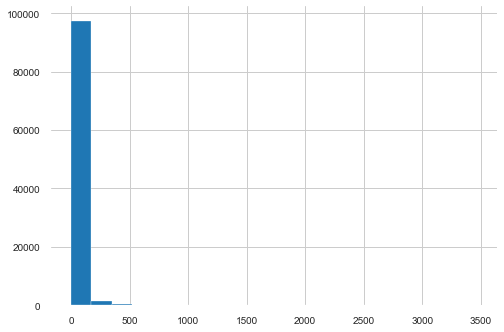

In [12]:
df.review_count.hist(bins=20)

Access multiple columns of a data frame, use the following syntax:

In [13]:
df[['name', 'review_count']].head(5)

,name,review_count
0,Chris,10
1,Tiffy,1
2,Mark,6
3,Evelyn,3
4,Lisa,11


Pandas https://pandas.pydata.org/pandas-docs/stable/getting_started/10min.html

Find the number of users that have more than 10 reviews on the platform.

In [14]:
len(df[df.review_count > 10])

33016

In [15]:
# Sorting
df[df.review_count > 10].sort_values(by='review_count', ascending=True)

,user_id,name,review_count,yelping_since,friends,useful,funny,cool,fans,elite,...,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
4,4E8--zUZO1Rr1IBK4_83fg,Lisa,11,2012-07-16,None,4,0,0,0,None,...,0,0,0,0,0,0,0,0,1,0
60730,cmdZxGoZMl1wywJw9riBEw,Amadeusz,11,2014-12-11,"q2gkAdh71OJE-4MGvTAWzQ, rmgthg5FptNa5fnVCXdJ7A...",0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
60773,IZzUlNGAahxB7SBLIGogEQ,Karen,11,2016-03-02,"zPABwowCMrfkIkfHrjRU7w, nmxRkzmWWHJxAoz_6Ct5BQ...",4,3,1,0,None,...,0,0,0,0,0,0,0,0,0,0
26479,DgP37v4XAKdstWzKsOLCRA,Amee,11,2013-04-13,None,3,0,0,1,None,...,0,0,0,0,0,0,0,0,0,0
60844,eByy7MlcuhPtNR68hC5C9g,Phil,11,2014-12-20,None,0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32097,NOUfyJW-BAo_-Cbfo8edww,Lolia,2363,2007-05-13,"FF47abH2LlxfrE8Vhsnrbg, SQzJ2mw201IV7xgYWVDlyw...",98208,25724,97378,573,"2007, 2009, 2008",...,2062,3740,2358,1358,4656,10789,23128,23128,6814,12655
4583,UsXqCXRZwSCSw0AT7y1uBg,Candice,2666,2008-01-25,"vawW_vlm-H-1xsqH8cKFOw, OBeuL-_9rMx9N6Lvakcf4Q...",29004,28722,28843,1872,"2014, 2013, 2012, 2009, 2015, 2011, 2017, 2010...",...,280,299,372,158,1657,5192,3327,3327,1368,888
89985,2l0O1EI1m0yWjFo2zSt71w,Shiho,2834,2005-07-02,"ZbZOuhkEtKtotaj7wL7E3w, huUq7cTpNnKbt8kQENu4aQ...",833,743,744,463,"2009, 2007, 2011, 2010, 2008, 2006",...,107,85,77,40,348,740,1060,1060,398,255
44812,7JpPvfDAE_14vA1xgFOFjw,Maria,3118,2008-04-26,"tcuAExccpI7fAfHZeoaFpg, ODsM6-_BvHt6-cqNylJn7g...",4450,3798,2919,210,"2013, 2014, 2016, 2015, 2017",...,58,45,4,5,344,916,631,631,309,75


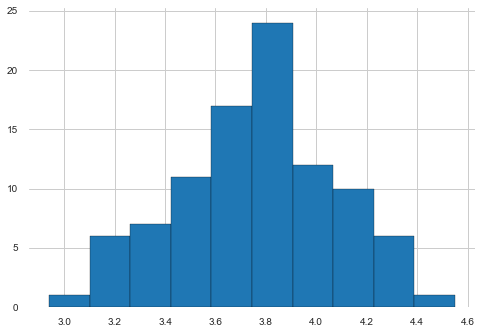

In [17]:
tmp_1000 = df[df.review_count > 1000]
tmp_1000['average_stars'].hist(ec='black')

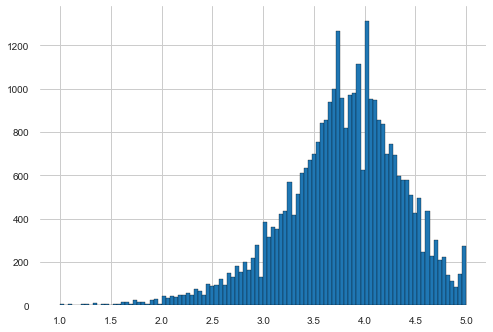

In [18]:
tmp_10 = df[df.review_count > 10]
tmp_10['average_stars'].hist(bins=100, ec='black')

In [19]:
tmp = df

### Numpy

Numpy: https://numpy.org/doc/1.17/user/quickstart.html.

The fundamental construct in numpy is the np.array(), which can turn almost anything into a matrix.

In [20]:
python_list = [[1,2,3], [4,5,6], [7,8,9]]
python_list

[[1, 2, 3], [4, 5, 6], [7, 8, 9]]

In [21]:
numpy_matrix = np.matrix(python_list)
numpy_matrix

matrix([[1, 2, 3],
        [4, 5, 6],
        [7, 8, 9]])

Indexing methods. Access rows, columns and single numbers of a matrix in a simple manner:

In [22]:
# Get matrices 2nd row and 1st column
print("3rd row, 2nd column number:")
print(numpy_matrix[2,1])

# Get first row of the matrix (: means slice, i.e. select all numbers)
print("First row:")
print(numpy_matrix[0,:])

# Get first column of the matrix
print("First column:")
print(numpy_matrix[:,0])

3rd row, 2nd column number:
8
First row:
[[1 2 3]]
First column:
[[1]
 [4]
 [7]]


You can turn the above matrix into a pandas dataframe simply by

In [23]:
pd.DataFrame(numpy_matrix, columns=['first_col', 'second_col', 'third_col'])

,first_col,second_col,third_col
0,1,2,3
1,4,5,6
2,7,8,9


And other way round, you can turn pandas dataframe into a numpy matrix. 'users' dataframe:

In [24]:
tmp[['review_count', 'useful', 'funny']].values

array([[10,  0,  0],
       [ 1,  0,  0],
       [ 6,  0,  0],
       ...,
       [ 1,  0,  0],
       [10,  0,  0],
       [12,  0,  0]])

As seen, the tradeoff is that I lose a lot of useful information, but on the other hand get a nice matrix which is efficient to modify.

Numpy has a large number of functions to get information about the matrix, here is mean and standard deviation. 

In [25]:
tmp_data = df[['review_count', 'useful', 'funny']].values

# Mean of first column
print(np.mean(tmp_data[:,0]))

# Standard deviation of second column:
print(np.std(tmp_data[:,1]))

23.643306433064332
592.5943321228746


Standard deviation of the 'useful' column is huge!

The sum of all reviews!

np.sum() function

In [26]:
df['review_count'].sum()

2364307

In [27]:
np.sum(df['review_count'])

2364307

The mean median of the review count.
np.median() function

In [28]:
df['review_count'].mean()

23.643306433064332

In [29]:
np.mean(df['review_count'])

23.643306433064332

### Pandas  indexing

In [30]:
tmp.head(5)

,user_id,name,review_count,yelping_since,friends,useful,funny,cool,fans,elite,...,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,JJ-aSuM4pCFPdkfoZ34q0Q,Chris,10,2013-09-24,"0njfJmB-7n84DlIgUByCNw, rFn3Xe3RqHxRSxWOU19Gpg...",0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
1,uUzsFQn_6cXDh6rPNGbIFA,Tiffy,1,2017-03-02,None,0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
2,mBneaEEH5EMyxaVyqS-72A,Mark,6,2015-03-13,None,0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
3,W5mJGs-dcDWRGEhAzUYtoA,Evelyn,3,2016-09-08,None,0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
4,4E8--zUZO1Rr1IBK4_83fg,Lisa,11,2012-07-16,None,4,0,0,0,None,...,0,0,0,0,0,0,0,0,1,0


The first five items of the dataframe above. At the left, is the index of the row. Notice that if I take some subset of the data, for example all users with the name Chris, the index does not reset:

In [31]:
df[df.name == 'Chris']

,user_id,name,review_count,yelping_since,friends,useful,funny,cool,fans,elite,...,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,JJ-aSuM4pCFPdkfoZ34q0Q,Chris,10,2013-09-24,"0njfJmB-7n84DlIgUByCNw, rFn3Xe3RqHxRSxWOU19Gpg...",0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
11,Mmv5fPxbF8XEMN4EPT_Khg,Chris,2,2016-06-24,None,0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
181,HyrFKNe43hPHVFoFgZ7AuQ,Chris,22,2014-07-06,None,0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
197,HnLtM53Ko1BY7DS737I06Q,Chris,2,2017-10-26,None,0,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
316,CAqTRA6o_19Bgresxn6R1w,Chris,16,2016-02-29,None,1,0,0,0,None,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99914,yPr31e8JjIp0P2Qbt9yfcA,Chris,18,2011-08-09,None,6,4,0,0,None,...,0,0,0,0,0,0,0,0,0,0
99960,tBtOjMnVjy7Kq-CPx67w_g,Chris,30,2011-02-18,"a6c7hXreFMWjVcoiNNiljg, 402n5ZGvXa7XWjDAn6uhfg...",27,3,3,1,None,...,0,0,0,0,0,0,1,1,0,0
99971,HsvDWPLp85FynWE0gHPi9g,Chris,48,2012-05-04,"BQJfh_mpfVb1_sRkB-Qo1A, q2odRqeOvAQVlN2LGM1nvA...",50,2,8,0,None,...,0,0,0,0,3,2,0,0,0,2
99977,R-Zw2sDjxW0Ue6wuGky3YA,Chris,3,2010-03-09,"XscY1qb7FJSVgntLZIm-iA, q50PWB-QR1YCHa60kagzgw...",2,3,2,0,None,...,0,0,0,0,0,0,0,0,0,0


Get a certain item in a dataframe, use the .iloc function:

In [32]:
# Access certain index in the df:
df.iloc[11] # iloc = index location

user_id               Mmv5fPxbF8XEMN4EPT_Khg
name                                   Chris
review_count                               2
yelping_since                     2016-06-24
friends                                 None
useful                                     0
funny                                      0
cool                                       0
fans                                       0
elite                                   None
average_stars                           1.67
compliment_hot                             0
compliment_more                            0
compliment_profile                         0
compliment_cute                            0
compliment_list                            0
compliment_note                            0
compliment_plain                           0
compliment_cool                            0
compliment_funny                           0
compliment_writer                          0
compliment_photos                          0
Name: 11, 

In [33]:
# The same iloc in the subset:
df[df.name == 'Chris'].iloc[11]

user_id                                          ABnqflUIsx4CRHv7ckUMOA
name                                                              Chris
review_count                                                          4
yelping_since                                                2013-08-17
friends               E7zeUWsaiAGyQk1aDwn72Q, cBNfp7PTPlO-fkKFvFYm7w...
useful                                                                0
funny                                                                 0
cool                                                                  0
fans                                                                  0
elite                                                              None
average_stars                                                       3.4
compliment_hot                                                        0
compliment_more                                                       0
compliment_profile                                              

In [34]:
df[df.name == 'Chris'].reset_index().iloc[11]

index                                                               980
user_id                                          ABnqflUIsx4CRHv7ckUMOA
name                                                              Chris
review_count                                                          4
yelping_since                                                2013-08-17
friends               E7zeUWsaiAGyQk1aDwn72Q, cBNfp7PTPlO-fkKFvFYm7w...
useful                                                                0
funny                                                                 0
cool                                                                  0
fans                                                                  0
elite                                                              None
average_stars                                                       3.4
compliment_hot                                                        0
compliment_more                                                 

The user with the highest number of reviews! 

In [35]:
idx = np.argmax(tmp.review_count)
print(tmp.name[idx])

Alden


In [36]:
tmp.reset_index().sort_values(by='review_count', ascending=True)

,index,user_id,name,review_count,yelping_since,friends,useful,funny,cool,fans,...,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
79081,79081,2WmGb0fKKv7qV4msEpvHcw,enbren,0,2008-09-30,None,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
85679,85679,tM-LuoQZFvLw8_pRo5qDcA,par,0,2008-05-15,None,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
23671,23671,p0GqHf8fdZDIsNfwx7XyFg,Gracel,0,2009-07-19,None,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
37263,37263,3vyhk67thp9GfG7xP9hrfQ,leckeress,0,2009-02-01,None,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
64090,64090,-lfArh6lSfDddoa-KP5ZPQ,snek,0,2008-07-19,None,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32097,32097,NOUfyJW-BAo_-Cbfo8edww,Lolia,2363,2007-05-13,"FF47abH2LlxfrE8Vhsnrbg, SQzJ2mw201IV7xgYWVDlyw...",98208,25724,97378,573,...,2062,3740,2358,1358,4656,10789,23128,23128,6814,12655
4583,4583,UsXqCXRZwSCSw0AT7y1uBg,Candice,2666,2008-01-25,"vawW_vlm-H-1xsqH8cKFOw, OBeuL-_9rMx9N6Lvakcf4Q...",29004,28722,28843,1872,...,280,299,372,158,1657,5192,3327,3327,1368,888
89985,89985,2l0O1EI1m0yWjFo2zSt71w,Shiho,2834,2005-07-02,"ZbZOuhkEtKtotaj7wL7E3w, huUq7cTpNnKbt8kQENu4aQ...",833,743,744,463,...,107,85,77,40,348,740,1060,1060,398,255
44812,44812,7JpPvfDAE_14vA1xgFOFjw,Maria,3118,2008-04-26,"tcuAExccpI7fAfHZeoaFpg, ODsM6-_BvHt6-cqNylJn7g...",4450,3798,2919,210,...,58,45,4,5,344,916,631,631,309,75


In [37]:
tmp.iloc[15223]

user_id                                          EHnOYbhNIEgXmU6HymG-Uw
name                                                               Gina
review_count                                                          2
yelping_since                                                2010-09-04
friends               yt7XFYNKr1x9U7ZPfhg-dA, kkL2cXBThV_rGjAGSD_9yw...
useful                                                                6
funny                                                                 0
cool                                                                  0
fans                                                                  0
elite                                                              None
average_stars                                                       1.5
compliment_hot                                                        0
compliment_more                                                       0
compliment_profile                                              

### Matplotlib

Matplotlib: https://matplotlib.org/tutorials/introductory/usage.html#sphx-glr-tutorials-introductory-usage-py.

Text(0, 0.5, 'Average stars')

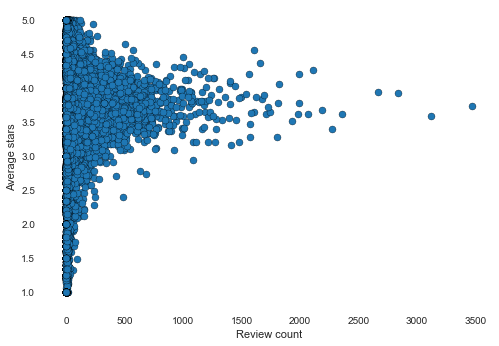

In [38]:
plt.figure()
plt.scatter(x=tmp.review_count, y=tmp.average_stars, ec='black')
plt.xlabel('Review count')
plt.ylabel('Average stars')

plt.hist()

No handles with labels found to put in legend.


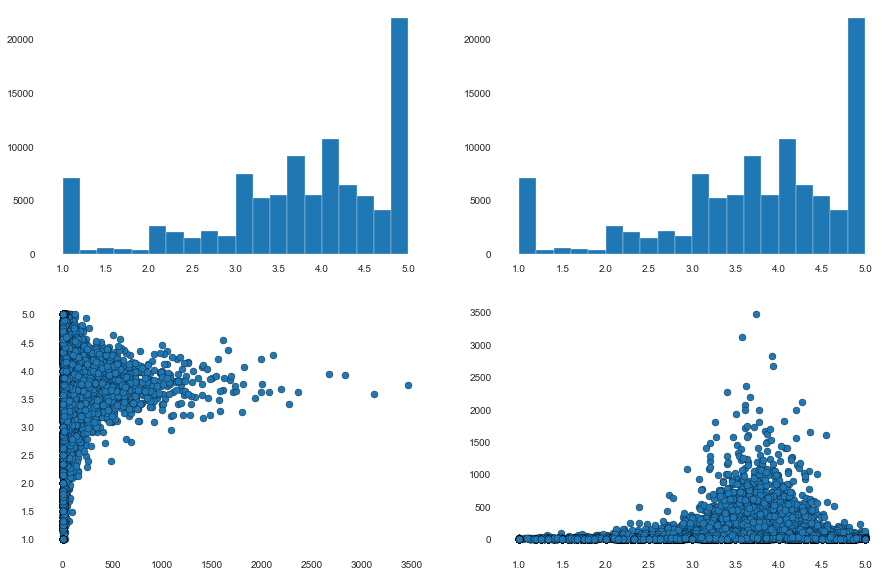

In [73]:
fig, ax = plt.subplots(2,2, figsize=(15,10))

ax[0,0].hist(df.average_stars, bins=20)
ax[0,0]

ax[0,1].hist(tmp.average_stars, bins=20)
ax[0,1]

ax[1,0].scatter(x=tmp.review_count, y=tmp.average_stars, ec='black')

ax[1,1].scatter(x=tmp.average_stars, y=tmp.review_count, ec='black')

ax[1,0].legend()

#plt.hist(tmp.average_stars, ec='black')

Correlation matrix. Use pandas function df.corr() to get the correlation matrix, and plt.matshow() function to plot it. More colors, change the color map in the plotting function with argument cmap='jet'.

<Figure size 720x720 with 0 Axes>

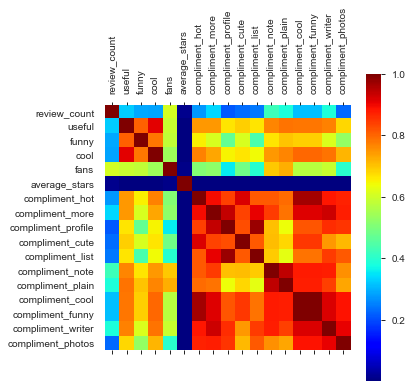

In [40]:
plt.figure(figsize=(10,10))

# Plotting code here
plt.matshow(df.corr(), cmap='jet')
plt.colorbar()

plt.xticks(np.arange(0,len(df.corr().columns)), df.corr().columns, rotation='vertical')
plt.yticks(np.arange(0,len(df.corr().columns)), df.corr().columns)
plt.show()

### Visualizing with Principal component analysis

Principal component analysis (PCA): tries to represent the data using fewer features by projecting dimensions to the direction of their variance. Know more, check wikipedia or this link: https://www.dezyre.com/data-science-in-python-tutorial/principal-component-analysis-tutorial

Use pca to reduce the dimensions to just two, which can be plot. We use sklearn's prebuilt PCA function to calculate the values.

In [41]:
np.unique(df.elite)

array(['2005', '2005, 2006', '2005, 2008, 2007, 2006', ...,
       '2017, 2016, 2015, 2014, 2013, 2012',
       '2017, 2016, 2015, 2014, 2013, 2012, 2011', 'None'], dtype=object)

In [43]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

In [44]:
# Grab the numerical features of the dataset for simplicity
numerical_data = tmp.select_dtypes(include=[np.number])

tsne = TSNE(n_components=2)
pca = PCA(n_components=2)
data_transformed = pca.fit_transform(numerical_data)
data_transformed_tsne = tsne.fit_transform(numerical_data)

In [45]:
numerical_data

,review_count,useful,funny,cool,fans,average_stars,compliment_hot,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,10,0,0,0,0,3.70,0,0,0,0,0,0,0,0,0,0,0
1,1,0,0,0,0,2.00,0,0,0,0,0,0,0,0,0,0,0
2,6,0,0,0,0,4.67,0,0,0,0,0,0,0,0,0,0,0
3,3,0,0,0,0,4.67,0,0,0,0,0,0,0,0,0,0,0
4,11,4,0,0,0,3.45,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99994,34,0,0,0,0,4.59,0,0,0,0,0,0,0,0,0,0,0
99995,103,55,18,34,6,4.27,10,0,0,0,0,6,3,17,17,1,5
99996,1,0,0,0,0,5.00,0,0,0,0,0,0,0,0,0,0,0
99997,10,0,0,0,1,3.20,0,1,0,0,0,0,0,0,0,0,0


In [46]:
print(data_transformed.shape)
print(data_transformed_tsne.shape)

(99999, 2)
(99999, 2)


In [47]:
print(pca.explained_variance_ratio_) # first column explains 89% of the data and second column explains 4% more


[0.89748144 0.04310346]


The data_transformed now only has two dimensions. Plot them in a 2D scatter plot! Need to use the numpy indexing to select one column and all rows as x-axis and the second column and all its rows as the y-axis.

In [49]:
%matplotlib inline

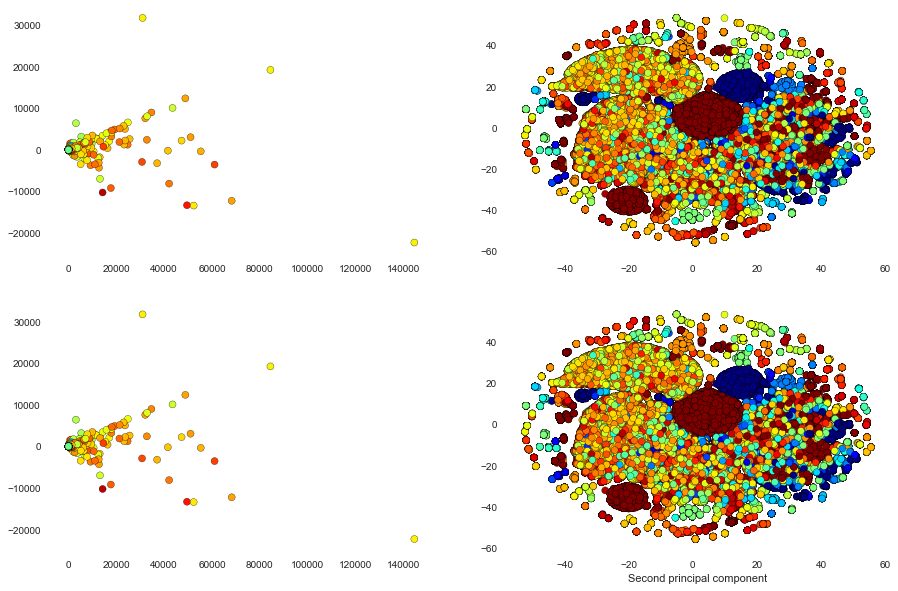

In [50]:
fig, ax = plt.subplots(2,2, figsize=(15,10))

ax[0,0].scatter(x=data_transformed[:,0], y=data_transformed[:,1], ec='black', c=numerical_data.average_stars, cmap='jet')

ax[0,1].scatter(x=data_transformed_tsne[:,0], y=data_transformed_tsne[:,1], ec='black', c=numerical_data.average_stars, cmap='jet')

ax[1,0].scatter(x=data_transformed[:,0], y=data_transformed[:,1], ec='black', c=numerical_data.average_stars, cmap='jet')

ax[1,1].scatter(x=data_transformed_tsne[:,0], y=data_transformed_tsne[:,1], ec='black', c=numerical_data.average_stars, cmap='jet')

plt.xlabel('First principal component')
plt.xlabel('Second principal component')
plt.show()

## SKLearn

I want to know what rating a user will give in advance!

Predict the user's average star rating based on the other features the user has. Start by grabbing all the numerical columns in the dataset (I'll skip the non-numerical ones in this personal excercise, but the non-numericals would've been handeled with one-hot encoding (OneHotEncoder())).

In [51]:
df.select_dtypes(include=[np.number]) #Select only the numerical values

,review_count,useful,funny,cool,fans,average_stars,compliment_hot,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,10,0,0,0,0,3.70,0,0,0,0,0,0,0,0,0,0,0
1,1,0,0,0,0,2.00,0,0,0,0,0,0,0,0,0,0,0
2,6,0,0,0,0,4.67,0,0,0,0,0,0,0,0,0,0,0
3,3,0,0,0,0,4.67,0,0,0,0,0,0,0,0,0,0,0
4,11,4,0,0,0,3.45,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99994,34,0,0,0,0,4.59,0,0,0,0,0,0,0,0,0,0,0
99995,103,55,18,34,6,4.27,10,0,0,0,0,6,3,17,17,1,5
99996,1,0,0,0,0,5.00,0,0,0,0,0,0,0,0,0,0,0
99997,10,0,0,0,1,3.20,0,1,0,0,0,0,0,0,0,0,0


In [52]:
df_numerical = df.select_dtypes(include=[np.number])
df_numerical.head(5)

,review_count,useful,funny,cool,fans,average_stars,compliment_hot,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,10,0,0,0,0,3.70,0,0,0,0,0,0,0,0,0,0,0
1,1,0,0,0,0,2.00,0,0,0,0,0,0,0,0,0,0,0
2,6,0,0,0,0,4.67,0,0,0,0,0,0,0,0,0,0,0
3,3,0,0,0,0,4.67,0,0,0,0,0,0,0,0,0,0,0
4,11,4,0,0,0,3.45,0,0,0,0,0,0,0,0,0,1,0


To predict the average star rating based on other features, I need a model. A model is a function that maps from features to the target variable. This function can be very simple, like a linear model you learned about in high school: 
$$
f: y = kx + b
$$

That's easy to solve, as 
$$
b = mean(y)
$$
and 
$$
k = \frac{y - b}{x}
$$

Where $y$ is the target variable (here, average stars) and $x$ some feature, like review_count. I could include more features in the linear function:

$$
f: y = w_1x_1 + w_2x_2 + w_3x_3 + ... w_kx_k + b
$$

where each $x_1, x_2, ..., x_k$ is a different feature in the dataset and $w_1, w_2, ..., w_k$ a weight for that feature that is used for prediction. Matematicians will see that $\vec{w}$ and $\vec{x}$ can be represented as vectors or matrices:

$$
\vec{w} = [w_1, w_2, ..., w_k, w_b]
$$
$$
\vec{x} = [x_1, x_2, ..., x_k, 1]
$$

Here the bias $b$ is incorporated in the $\vec{x}$ array as a column of ones. Using the dot product, the above function reduces to:

$$
y = \vec{w}^T\vec{x}
$$

(check the wikipedia page on dot product if you need a refresh on matrices and vectors).

In a dataset, I have many samples, so I stack them into a matrix where rows are samples and columns the feature vectors. In this way, I can predict a large number of samples in one shot:

$$
\vec{y} = \vec{X}\vec{w}
$$

### Sklearn

In [53]:
y = df_numerical['average_stars']
X = df_numerical.drop('average_stars', axis=1)

In [54]:
y.head(10)

0    3.70
1    2.00
2    4.67
3    4.67
4    3.45
5    4.78
6    5.00
7    1.00
8    4.29
9    5.00
Name: average_stars, dtype: float64

In [55]:
X.head(10)

,review_count,useful,funny,cool,fans,compliment_hot,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,10,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,11,4,0,0,0,0,0,0,0,0,0,0,0,0,1,0
5,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [56]:
X.shape

(99999, 16)

Separate training and test set so that I won't test a model with data it has already seen.

Start by splitting the dataset into a training and validation set. This is easy with sklearn's preprocessing module:

In [57]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [58]:
print(len(X_train), len(y_train), len(X_test), len(y_test))

74999 74999 25000 25000


I use a simple random forest model (read more about it here: https://towardsdatascience.com/understanding-random-forest-58381e0602d2)

Import the model, fit the data to it and then predict the test data. Afterwards, look at the results and the accuracy of our model.

In [59]:
from sklearn.ensemble import RandomForestRegressor

In [60]:
regr = RandomForestRegressor(max_depth=5, random_state=0, n_estimators=100)
regr.fit(X_train, y_train)
y_pred = regr.predict(X_test)

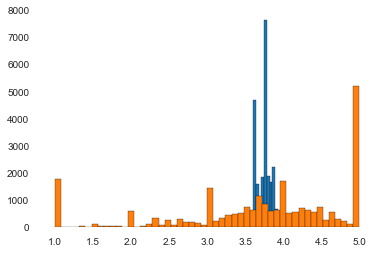

In [61]:
plt.hist(y_pred, ec='black', bins=50)
plt.hist(y_test, ec='black', bins=50)
plt.show()

In [62]:
# Calculate mean squared error
mse = np.mean((y_pred - y_test)**2)

In [63]:
mse

1.264230878069125

In [64]:
# Mean absolut error
np.mean(np.abs(y_pred - y_test))

0.8811939602475947

Mean squared error was 1.264. Now predict the average stars of a user using this model!

Calculate the mean average error and see how it differs from the root of the mean squared error.

In [72]:
mae = np.mean(np.abs(y_pred - y_test))
print(mae)
print(np.sqrt(mse))

0.8811939602475947
1.1243802195294637


Find out the mean and standard deviation of the predictions array y_pred

In [71]:

print(np.mean(y_pred))
print(np.mean(np.sqrt(y_pred)))

3.7211229407932773
1.9286810780181882


Make own feature vector that might have on the platform, and predict what your average star rating is.

In [70]:
X.columns

Index(['review_count', 'useful', 'funny', 'cool', 'fans', 'compliment_hot',
       'compliment_more', 'compliment_profile', 'compliment_cute',
       'compliment_list', 'compliment_note', 'compliment_plain',
       'compliment_cool', 'compliment_funny', 'compliment_writer',
       'compliment_photos'],
      dtype='object')

In [68]:
own_array = np.asarray([600, 105, 44, 66, 200, 10, 40, 30, 50, 20, 10, 100, 40, 30, 30, 1])
own_array = own_array.reshape(1, -1)
print(own_array.reshape(1, -1))
print(own_array.shape)
own_array_star = regr.predict(own_array)
print(own_array_star)

[[600 105  44  66 200  10  40  30  50  20  10 100  40  30  30   1]]
(1, 16)
[3.79042209]


It is useful to see what variables were the most important after fitting a model. TValues with the feature_importances property of the model.

Take a look at https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html

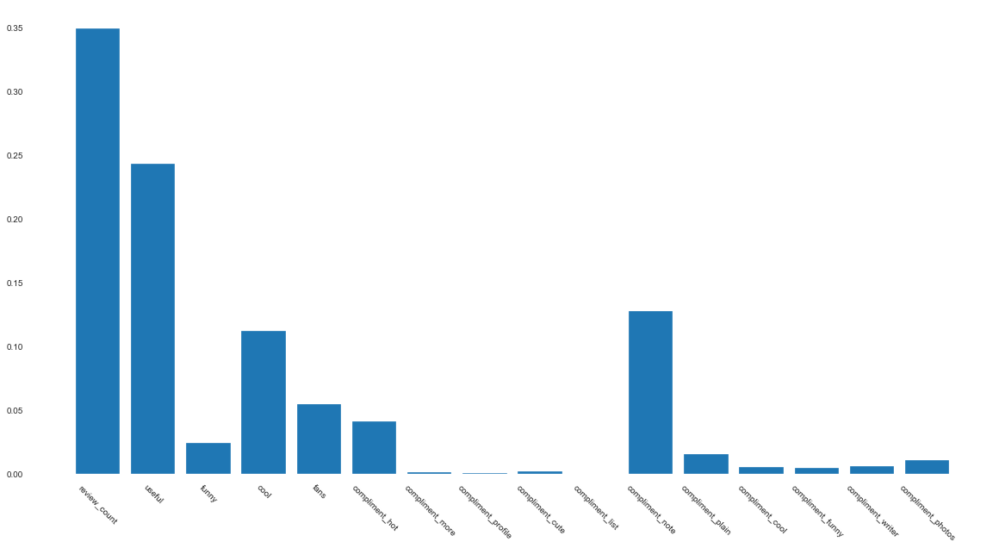

In [69]:
plt.figure(figsize=(20,10))
importances = regr.feature_importances_
plt.bar(range(len(X.columns)), importances)

plt.xticks(range(len(X.columns)), X.columns, rotation=-45)
plt.show()

Check sklearn's supervised learning module at https://scikit-learn.org/stable/supervised_learning.html, pick some other model than random forest and experiment with the results.